In [1]:
# Import the dependencies.
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Use the citipy module to determine city based on latitude and longitude.
from citipy import citipy
from config import weather_api_key

import requests 
# Import the datetime module from the datetime library.
from datetime import datetime
import time
# Import linear regression from the SciPy stats module.
from scipy.stats import linregress

In [2]:
url = "http://api.openweathermap.org/data/2.5/weather?units=Imperial&APPID=" + weather_api_key
print(url)

http://api.openweathermap.org/data/2.5/weather?units=Imperial&APPID=d4cb209770713b56aa45c40025b8cc28


In [3]:
# Create a set of random latitude and longitude combinations.
lats = np.random.uniform(low=-90.000, high=90.000, size=1500)
lngs = np.random.uniform(low=-180.000, high=180.000, size=1500)
lat_lngs = zip(lats, lngs)
lat_lngs

In [4]:
# Add the latitudes and longitudes to a list.
#coordinates = list(lat_lngs)

In [5]:
x = [25.12903645, 25.92017388, 26.62509167, -59.98969384, 37.30571269]
y = [-67.59741259, 11.09532135, 74.84233102, -76.89176677, -61.13376282]
coordinates = zip(x, y)

In [6]:
from citipy import citipy

# Use the tuple() function to display the latitude and longitude combinations.
for coordinate in coordinates:
    print(citipy.nearest_city(coordinate[0], coordinate[1]).city_name,
          citipy.nearest_city(coordinate[0], coordinate[1]).country_code)

cockburn town tc
gat ly
parvatsar in
punta arenas cl
saint george bm


In [7]:
# Create a list for holding the cities.
cities = []

# Identify the nearest city for each latitude and longitude combination.
for coordinate in lat_lngs:
    city = citipy.nearest_city(coordinate[0], coordinate[1]).city_name

    # If the city is unique, then we will add it to the cities list.
    if city not in cities:
        cities.append(city)

        # Print the city count to confirm sufficient count.
len(cities)

591

In [8]:
import requests 
# Create an empty list to hold the weather data.
city_data = []
# Print the beginning of the logging.
print("Beginning Data Retrieval     ")
print("-----------------------------")

# Create counters.
record_count = 1
set_count = 1

# Loop through all the cities in our list.
for i in range(len(cities)):

    # Group cities in sets of 50 for logging purposes.
    if (i % 50 == 0 and i >= 50):
        set_count += 1
        record_count = 1
    # Create endpoint URL with each city.
    city_url = url + "&q=" + "i"
    
# Loop through all the cities in the list.
for i, city in enumerate(cities):

    # Group cities in sets of 50 for logging purposes.
    if (i % 50 == 0 and i >= 50):
        set_count += 1
        record_count = 1
    # Create endpoint URL with each city.
    city_url = url + "&q=" + city.replace(" ","+")

    # Log the URL, record, and set numbers and the city.
    print(f"Processing Record {record_count} of Set {set_count} | {city}")
    # Add 1 to the record count.
    record_count += 1

# Run an API request for each of the cities.
    try:
        # Parse the JSON and retrieve data.
        city_weather = requests.get(city_url).json()
        # Parse out the needed data.
        city_lat = city_weather["coord"]["lat"]
        city_lng = city_weather["coord"]["lon"]
        city_max_temp = city_weather["main"]["temp_max"]
        city_humidity = city_weather["main"]["humidity"]
        city_clouds = city_weather["clouds"]["all"]
        city_wind = city_weather["wind"]["speed"]
        city_country = city_weather["sys"]["country"]
        # Convert the date to ISO standard.
        city_date = datetime.utcfromtimestamp(city_weather["dt"]).strftime('%Y-%m-%d %H:%M:%S')
        # Append the city information into city_data list.
        city_data.append({"City": city.title(),
                          "Lat": city_lat,
                          "Lng": city_lng,
                          "Max Temp": city_max_temp,
                          "Humidity": city_humidity,
                          "Cloudiness": city_clouds,
                          "Wind Speed": city_wind,
                          "Country": city_country,
                          "Date": city_date})
        print(city_data)
# If an error is experienced, skip the city.
    except KeyError:
        print("City not found. Skipping...")
        pass

# Indicate that Data Loading is complete.
print("-----------------------------")
print("Data Retrieval Complete      ")
print("-----------------------------")

Beginning Data Retrieval     
-----------------------------
Processing Record 1 of Set 12 | new norfolk
[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}]
Processing Record 2 of Set 12 | chokurdakh
[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}]
Processing Record 3 of Set 12 | waipawa
[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Win

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

City not found. Skipping...
Processing Record 17 of Set 12 | rikitea
[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Tem

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

City not found. Skipping...
Processing Record 17 of Set 13 | belmonte
[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Te

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

City not found. Skipping...
Processing Record 41 of Set 13 | barentsburg
City not found. Skipping...
Processing Record 42 of Set 13 | napanee
[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

City not found. Skipping...
Processing Record 23 of Set 14 | mazatlan
[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Te

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

City not found. Skipping...
Processing Record 43 of Set 14 | kaabong
[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Tem

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

City not found. Skipping...
Processing Record 1 of Set 16 | ribeira grande
[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'M

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

City not found. Skipping...
Processing Record 10 of Set 16 | esperance
[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max T

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

City not found. Skipping...
Processing Record 16 of Set 16 | kavieng
[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Tem

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

City not found. Skipping...
Processing Record 47 of Set 16 | pedernales
[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max 

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

City not found. Skipping...
Processing Record 9 of Set 18 | seoul
[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp':

City not found. Skipping...
Processing Record 12 of Set 18 | gizo
[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp':

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

City not found. Skipping...
Processing Record 27 of Set 18 | bur gabo
City not found. Skipping...
Processing Record 28 of Set 18 | shenzhen
[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

City not found. Skipping...
Processing Record 6 of Set 20 | juniyah
City not found. Skipping...
Processing Record 7 of Set 20 | concepcion del oro
[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-3

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

City not found. Skipping...
Processing Record 48 of Set 20 | eresos
[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

City not found. Skipping...
Processing Record 33 of Set 23 | pedra branca
[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Ma

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

[{'City': 'New Norfolk', 'Lat': -42.78, 'Lng': 147.06, 'Max Temp': 51.01, 'Humidity': 69, 'Cloudiness': 34, 'Wind Speed': 2.42, 'Country': 'AU', 'Date': '2020-10-31 19:45:46'}, {'City': 'Chokurdakh', 'Lat': 70.63, 'Lng': 147.92, 'Max Temp': -4.67, 'Humidity': 92, 'Cloudiness': 98, 'Wind Speed': 7.9, 'Country': 'RU', 'Date': '2020-10-31 19:48:27'}, {'City': 'Waipawa', 'Lat': -41.41, 'Lng': 175.52, 'Max Temp': 61, 'Humidity': 72, 'Cloudiness': 6, 'Wind Speed': 16.11, 'Country': 'NZ', 'Date': '2020-10-31 19:48:27'}, {'City': 'Taoudenni', 'Lat': 22.68, 'Lng': -3.98, 'Max Temp': 81.73, 'Humidity': 16, 'Cloudiness': 100, 'Wind Speed': 10.63, 'Country': 'ML', 'Date': '2020-10-31 19:48:27'}, {'City': 'Sinnamary', 'Lat': 5.38, 'Lng': -52.95, 'Max Temp': 84.22, 'Humidity': 71, 'Cloudiness': 100, 'Wind Speed': 11.86, 'Country': 'GF', 'Date': '2020-10-31 19:48:28'}, {'City': 'Santa Barbara', 'Lat': 34.73, 'Lng': -120.03, 'Max Temp': 87.01, 'Humidity': 18, 'Cloudiness': 1, 'Wind Speed': 3.36, 'Coun

In [9]:
# Convert the array of dictionaries to a Pandas DataFrame.
city_data_df = pd.DataFrame(city_data)
city_data_df.head(10)

,City,Lat,Lng,Max Temp,Humidity,Cloudiness,Wind Speed,Country,Date
0,New Norfolk,-42.78,147.06,51.01,69,34,2.42,AU,2020-10-31 19:45:46
1,Chokurdakh,70.63,147.92,-4.67,92,98,7.90,RU,2020-10-31 19:48:27
2,Waipawa,-41.41,175.52,61.00,72,6,16.11,NZ,2020-10-31 19:48:27
3,Taoudenni,22.68,-3.98,81.73,16,100,10.63,ML,2020-10-31 19:48:27
4,Sinnamary,5.38,-52.95,84.22,71,100,11.86,GF,2020-10-31 19:48:28
5,Santa Barbara,34.73,-120.03,87.01,18,1,3.36,US,2020-10-31 19:48:28
6,Dire,12.28,-10.97,80.04,42,71,2.57,ML,2020-10-31 19:48:28
7,Mataura,-46.19,168.86,54.00,74,51,5.99,NZ,2020-10-31 19:48:28
8,Touros,-5.20,-35.46,84.20,70,40,14.99,BR,2020-10-31 19:46:31
9,Mikkeli,61.69,27.27,39.20,93,90,5.82,FI,2020-10-31 19:48:28


In [37]:
# Create the output file (CSV).
output_data_file = "weather_data/cities.csv"
# Export the City_Data into a CSV.
city_data_df.to_csv(output_data_file, index_label="City_ID")

In [10]:
# Extract relevant fields from the DataFrame for plotting.
lats = city_data_df["Lat"]
max_temps = city_data_df["Max Temp"]
humidity = city_data_df["Humidity"]
cloudiness = city_data_df["Cloudiness"]
wind_speed = city_data_df["Wind Speed"]

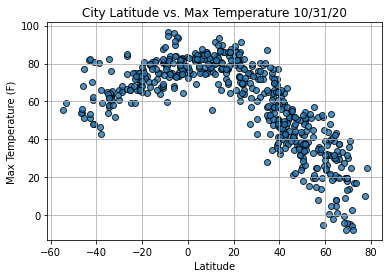

In [11]:
# Build the scatter plot for latitude vs. max temperature.
plt.scatter(lats,
            max_temps,
            edgecolor="black", linewidths=1, marker="o",
            alpha=0.8, label="Cities")

# Incorporate the other graph properties.
plt.title(f"City Latitude vs. Max Temperature "+ time.strftime("%x"))
plt.ylabel("Max Temperature (F)")
plt.xlabel("Latitude")
plt.grid(True)

# Save the figure.
# plt.savefig("/Fig1.png")

# Show plot.
plt.show()

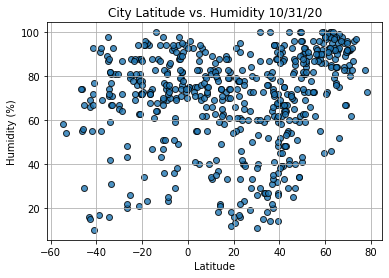

In [12]:
# Build the scatter plots for latitude vs. humidity.
plt.scatter(lats,
            humidity,
            edgecolor="black", linewidths=1, marker="o",
            alpha=0.8, label="Cities")

# Incorporate the other graph properties.
plt.title(f"City Latitude vs. Humidity "+ time.strftime("%x"))
plt.ylabel("Humidity (%)")
plt.xlabel("Latitude")
plt.grid(True)
# Save the figure.
#plt.savefig("weather_data/Fig2.png")
# Show plot.
plt.show()

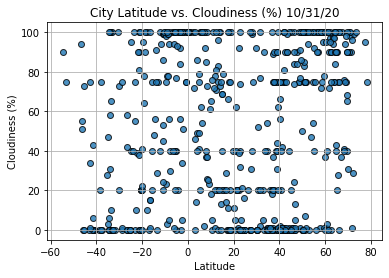

In [13]:
# Build the scatter plots for latitude vs. cloudiness.
plt.scatter(lats,
            cloudiness,
            edgecolor="black", linewidths=1, marker="o",
            alpha=0.8, label="Cities")

# Incorporate the other graph properties.
plt.title(f"City Latitude vs. Cloudiness (%) "+ time.strftime("%x"))
plt.ylabel("Cloudiness (%)")
plt.xlabel("Latitude")
plt.grid(True)
# Save the figure.
#plt.savefig("weather_data/Fig3.png")
# Show plot.
plt.show()

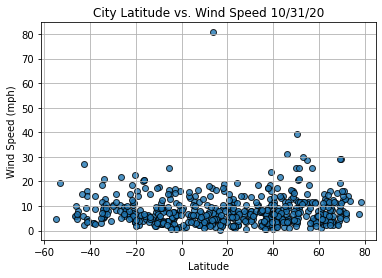

In [14]:
# Build the scatter plots for latitude vs. wind speed.
plt.scatter(lats,
            wind_speed,
            edgecolor="black", linewidths=1, marker="o",
            alpha=0.8, label="Cities")

# Incorporate the other graph properties.
plt.title(f"City Latitude vs. Wind Speed "+ time.strftime("%x"))
plt.ylabel("Wind Speed (mph)")
plt.xlabel("Latitude")
plt.grid(True)
# Save the figure.
#plt.savefig("weather_data/Fig4.png")
# Show plot.
plt.show()

In [15]:
# Create a function to create perform linear regression on the weather data
# and plot a regression line and the equation with the data.
def plot_linear_regression(x_values, y_values, title, y_label, text_coordinates):

    # Run regression on hemisphere weather data.
    (slope, intercept, r_value, p_value, std_err) = linregress(x_values, y_values)

    # Calculate the regression line "y values" from the slope and intercept.
    regress_values = x_values * slope + intercept
    # Get the equation of the line.
    line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
    # Create a scatter plot and plot the regression line.
    plt.scatter(x_values,y_values)
    plt.plot(x_values,regress_values,"r")
    # Annotate the text for the line equation.
    plt.annotate(line_eq, text_coordinates, fontsize=15, color="red")
    plt.xlabel('Latitude')
    plt.ylabel(y_label)
    plt.show()

In [16]:
index13 = city_data_df.loc[13]
index13

City                       Kodiak
Lat                         57.79
Lng                       -152.41
Max Temp                     33.8
Humidity                       55
Cloudiness                      1
Wind Speed                   3.36
Country                        US
Date          2020-10-31 19:46:09
Name: 13, dtype: object

In [17]:
city_data_df.loc[(city_data_df["Lat"] >= 0)]
city_data_df.head()

,City,Lat,Lng,Max Temp,Humidity,Cloudiness,Wind Speed,Country,Date
0,New Norfolk,-42.78,147.06,51.01,69,34,2.42,AU,2020-10-31 19:45:46
1,Chokurdakh,70.63,147.92,-4.67,92,98,7.90,RU,2020-10-31 19:48:27
2,Waipawa,-41.41,175.52,61.00,72,6,16.11,NZ,2020-10-31 19:48:27
3,Taoudenni,22.68,-3.98,81.73,16,100,10.63,ML,2020-10-31 19:48:27
4,Sinnamary,5.38,-52.95,84.22,71,100,11.86,GF,2020-10-31 19:48:28


In [18]:
# Create Northern and Southern Hemisphere DataFrames.
northern_hemi_df = city_data_df.loc[(city_data_df["Lat"] >= 0)]
southern_hemi_df = city_data_df.loc[(city_data_df["Lat"] < 0)]

In [19]:
# Import linear regression from the SciPy stats module.
from scipy.stats import linregress

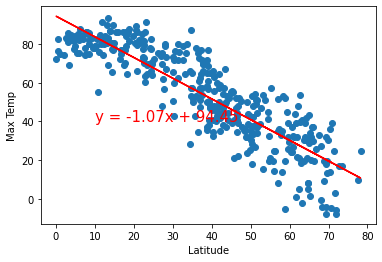

In [21]:
# Linear regression on the Northern Hemisphere
x_values = northern_hemi_df["Lat"]
y_values = northern_hemi_df["Max Temp"]
# Call the function.
plot_linear_regression(x_values, y_values,
                       'Linear Regression on the Northern Hemisphere for Maximum Temperature', 'Max Temp',(10,40))

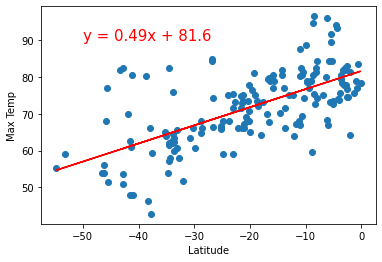

In [23]:
# Linear regression on the Southern Hemisphere
x_values = southern_hemi_df["Lat"]
y_values = southern_hemi_df["Max Temp"]
# Call the function.
plot_linear_regression(x_values, y_values,
                       'Linear Regression on the Southern Hemisphere for Maximum Temperature', 'Max Temp',(-50,90))

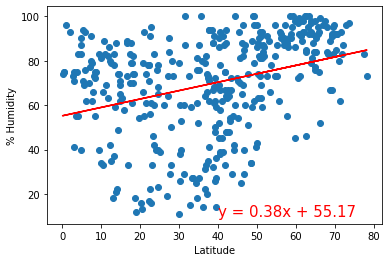

In [25]:
# Linear regression on the Northern Hemisphere
x_values = northern_hemi_df["Lat"]
y_values = northern_hemi_df["Humidity"]
# Call the function.
plot_linear_regression(x_values, y_values,
                       'Linear Regression on the Northern Hemisphere for % Humidity', '% Humidity',(40,10))

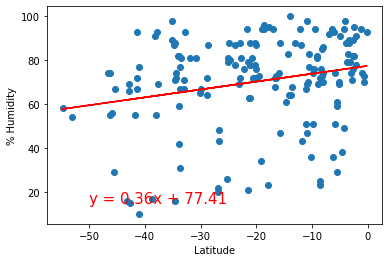

In [26]:
# Linear regression on the Southern Hemisphere
x_values = southern_hemi_df["Lat"]
y_values = southern_hemi_df["Humidity"]
# Call the function.
plot_linear_regression(x_values, y_values,
                       'Linear Regression on the Southern Hemisphere for % Humidity', '% Humidity',(-50,15))

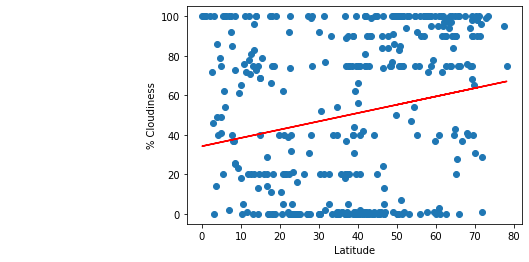

In [31]:
# Linear regression on the Northern Hemisphere
x_values = northern_hemi_df["Lat"]
y_values = northern_hemi_df["Cloudiness"]
# Call the function.
plot_linear_regression(x_values, y_values,
                       'Linear Regression on the Northern Hemisphere for % Cloudiness', '% Cloudiness',(-50,60))

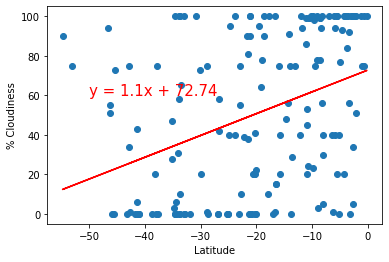

In [33]:
# Linear regression on the Southern Hemisphere
x_values = southern_hemi_df["Lat"]
y_values = southern_hemi_df["Cloudiness"]
# Call the function.
plot_linear_regression(x_values, y_values,
                       'Linear Regression on the Southern Hemisphere for % Cloudiness', '% Cloudiness',(-50,60))

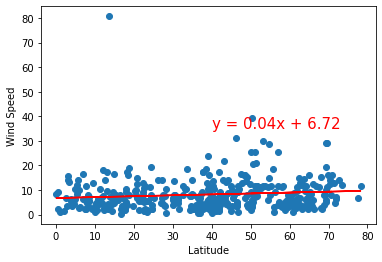

In [34]:
# Linear regression on the Northern Hemisphere
x_values = northern_hemi_df["Lat"]
y_values = northern_hemi_df["Wind Speed"]
# Call the function.
plot_linear_regression(x_values, y_values,
                       'Linear Regression on the Northern Hemisphere for Wind Speed', 'Wind Speed',(40,35))


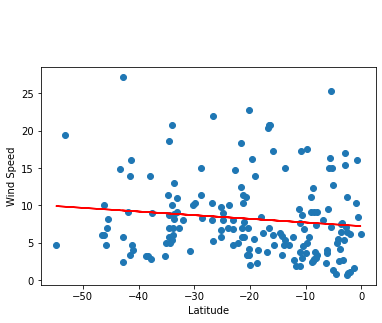

In [35]:
# Linear regression on the Southern Hemisphere
x_values = southern_hemi_df["Lat"]
y_values = southern_hemi_df["Wind Speed"]
# Call the function.
plot_linear_regression(x_values, y_values,
                       'Linear Regression on the Southern Hemisphere for Wind Speed', 'Wind Speed',(-50,35))